# Style transfer using GAN
This notebook will be used to prepare the capstone project 'Style transfer using GAN' <br>
In this project we will generate T2 MRI from T1 MRI images and vice versa

In [32]:
#Import all the required libraries
import tensorflow as tf
import matplotlib.pyplot as plt
import glob # to find certain directories
import imageio
from IPython import display
from skimage.transform import resize
from skimage.io import imread_collection
import numpy as np
import os # to access the folders and files
#from keras.utils.vis_utils import plot_model
from tensorflow.keras.utils import plot_model
from tensorflow import keras

## Data understanding
Import the images & create two seperate datasets. The input shape for image should be (256, 256)


In [33]:
#your path 
tr1_dir = "MRI_dataset/Tr1/"
tr2_dir = "MRI_dataset/Tr2/"

col = imread_collection(tr1_dir)
col1 = imread_collection(tr2_dir)
print(col)
print(col1)
tr1 = ""


['MRI_dataset/Tr1/']
['MRI_dataset/Tr2/']


In [34]:
tr1 = tf.keras.preprocessing.image_dataset_from_directory(tr1_dir, color_mode='grayscale', shuffle=True, seed=42, 
                                                          batch_size=1, label_mode=None, image_size=(256,256),
                                                         interpolation='nearest')

Found 43 files belonging to 1 classes.


In [35]:
tr2 = tf.keras.preprocessing.image_dataset_from_directory(tr2_dir, color_mode='grayscale', shuffle=True, seed=42, 
                                                          batch_size=1, label_mode=None, image_size=(256,256),
                                                         interpolation='nearest')

Found 46 files belonging to 1 classes.


## Image Processing 
1.Create a function to process your images with normalisation

2.Apply the function to both the datasets 

3.Visualise the MRI images after processing




In [36]:
# normalizing the images to [-1, 1]
def normalize(image):
    image = tf.cast(image,tf.float32)
    image = (image/127.5)-1
    return image

In [37]:
def preprocess_image_train(image):
    image = tf.image.random_flip_left_right(image)
    image = normalize(image)
    return image

In [38]:
# process both classes of MRI images
tr1 = tr1.map(preprocess_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache().shuffle(128)
tr2 = tr2.map(preprocess_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE).cache().shuffle(128)

In [39]:
sample_tr1 = next(iter(tr1))
sample_tr2 = next(iter(tr2))

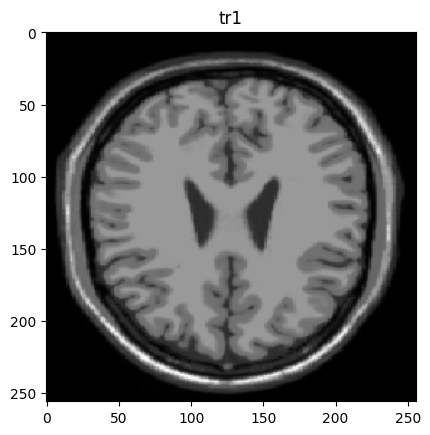

In [40]:
plt.title('tr1')
plt.imshow(sample_tr1[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

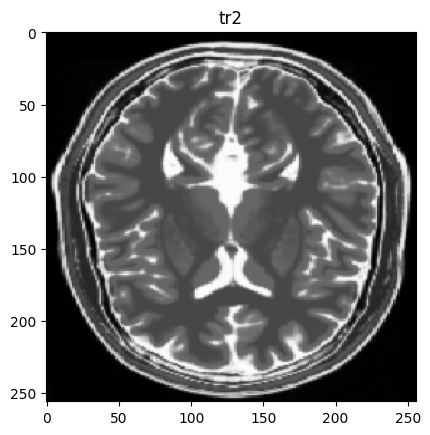

In [41]:
plt.title('tr2')
plt.imshow(sample_tr2[0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')

## Model Building & Training
The architecture of generator is a modified U-Net.

1.Create your Generator & Discriminator

2.Define the loss functions

3.Create the train_step function

In [42]:
class InstanceNormalization(tf.keras.layers.Layer):
    def __init__(self, epsilon=1e-5):
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    def call(self, x):
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    if apply_norm:
        result.add(InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    result.add(InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result

In [43]:
def unet_generator():
    down_stack = [
        downsample(64, 4, False),
        downsample(128, 4, False),
        downsample(256, 4, False),
        downsample(512, 4, False),
        downsample(512, 4, False),
        downsample(512, 4, False),
        downsample(512, 4, False),
        downsample(512, 4, False)
    ]
    up_stack = [
        upsample(512, 4, True),
        upsample(512, 4, True),
        upsample(512, 4, True),
        upsample(512, 4, True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(64, 4)
    ]
        
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 256, 256, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[None, None, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [44]:
generator_g = unet_generator()
generator_f = unet_generator()#initialise the generator

In [45]:
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = tf.keras.layers.Input(shape=[None, None, 1], name='input_image')
    x = inp
    down1 = downsample(64, 4, False)(x) #write your code to downsample X
    down2 = downsample(128, 4)(down1) #write your code to downsample down1
    down3 = downsample(256, 4)(down2) #write your code to downsample down2
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 31, 31, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)
    return tf.keras.Model(inputs=inp, outputs=last) #create the model using input & output layer

In [46]:
discriminator_x = discriminator() #initialise the discriminator
discriminator_y = discriminator()#initialise the discriminator

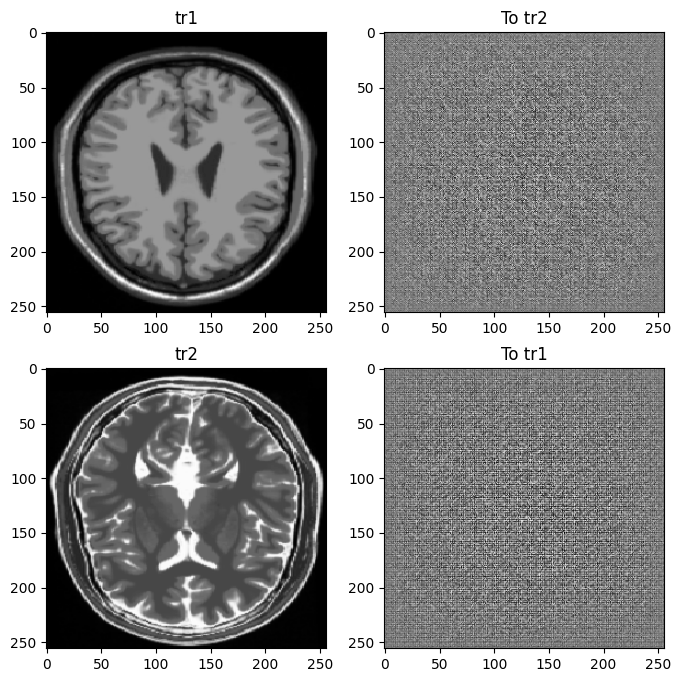

In [47]:
to_tr2 = generator_g(sample_tr1)
to_tr1 = generator_f(sample_tr2)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_tr1, to_tr2, sample_tr2, to_tr1]
title = ['tr1', 'To tr2', 'tr2', 'To tr1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
    else:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 * contrast + 0.5, cmap='gray')
plt.show()

In [48]:
LAMBDA = 10 #"Your Lambda Value Here"

In [49]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True) #"Your Binary-Cross-Entropy Loss Here"

In [50]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real) #write your code here
    generated_loss = loss_obj(tf.zeros_like(generated), generated) #write your code here
    total_disc_loss = real_loss + generated_loss #write your code here
    return total_disc_loss * 0.5

In [51]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

In [52]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image-cycled_image)) #write your code here
    return LAMBDA * loss1

In [53]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return LAMBDA * 0.5 * loss

In [54]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [60]:
EPOCHS = 350 #"Your Number of Epochs Here"

In [56]:
checkpoint_path = os.path.abspath("MRI_Models/")

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=EPOCHS)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

In [57]:
def generate_images(model, test_input, expected_output):
    prediction = model(test_input)
    plt.figure(figsize=(10, 10))
    display_list = [test_input[0], prediction[0], expected_output[0]]
    title = ['Input Image', 'Predicted Image', 'Expected Image']
    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
        plt.axis('off')
    plt.show()

In [58]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X.
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)
        
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)
        
        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)
        
        # calculate discriminator predictions for both discriminators on real and fake data
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)
        
        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)
        
        # calculate the generator loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)
        
        # calculate cycle loss for both the cycles
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Total generator loss = adversarial loss + cycle loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)
        
        # calculate discriminator loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

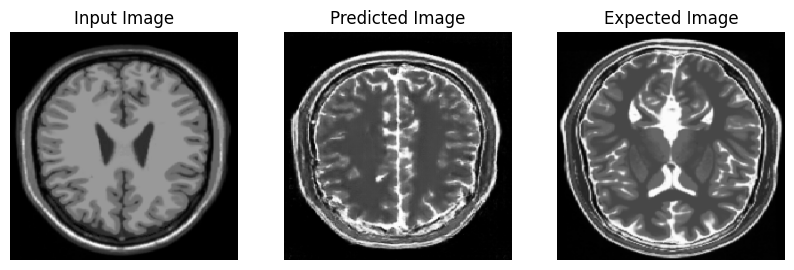

Saving checkpoint for epoch 0 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-251


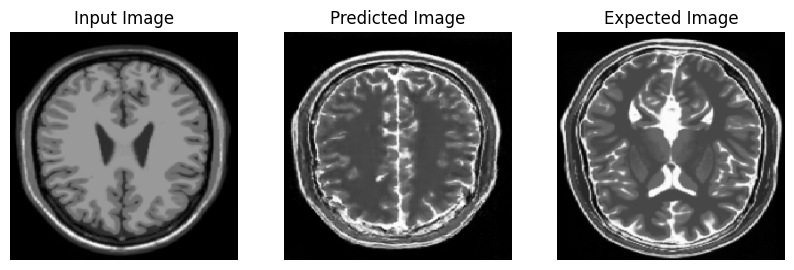

Saving checkpoint for epoch 1 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-252


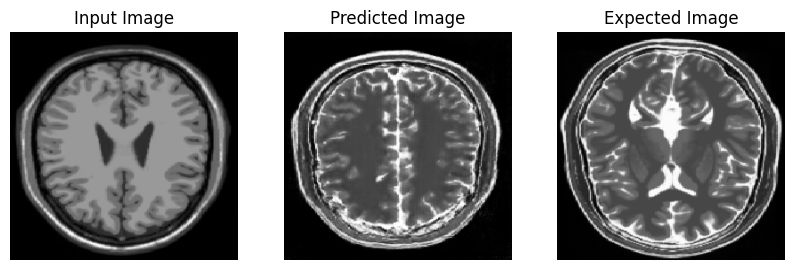

Saving checkpoint for epoch 2 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-253


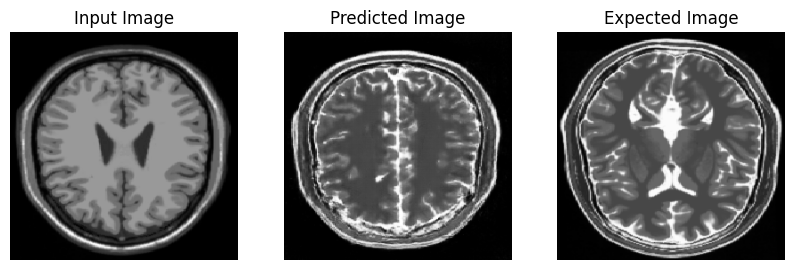

Saving checkpoint for epoch 3 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-254


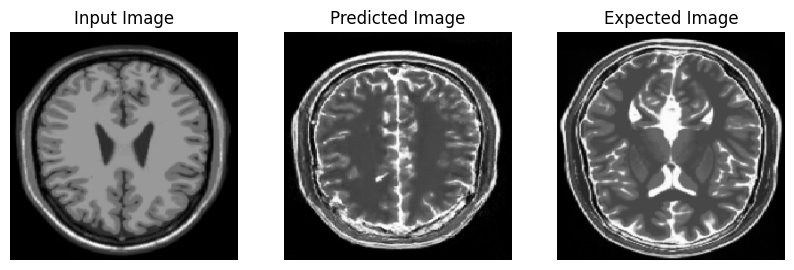

Saving checkpoint for epoch 4 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-255


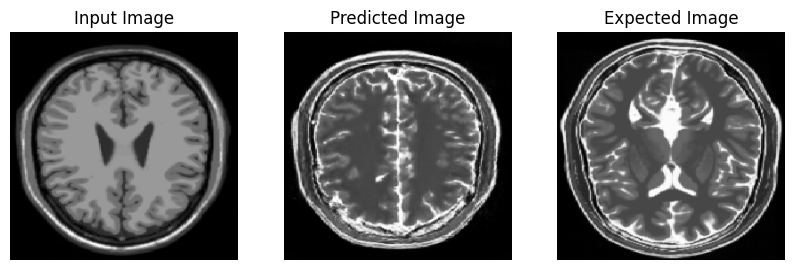

Saving checkpoint for epoch 5 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-256


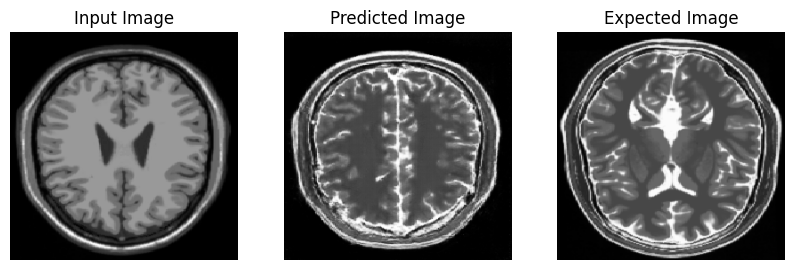

Saving checkpoint for epoch 6 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-257


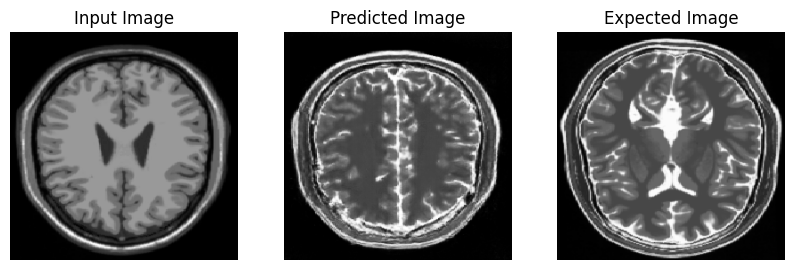

Saving checkpoint for epoch 7 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-258


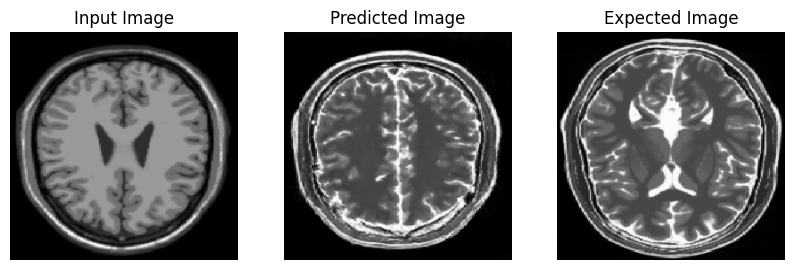

Saving checkpoint for epoch 8 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-259


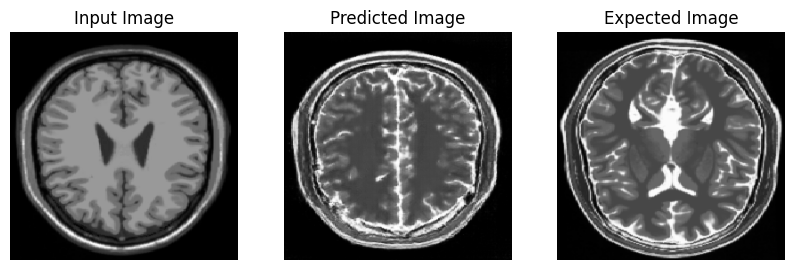

Saving checkpoint for epoch 9 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-260


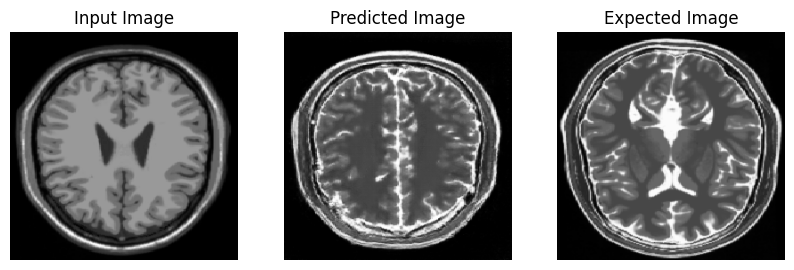

Saving checkpoint for epoch 10 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-261


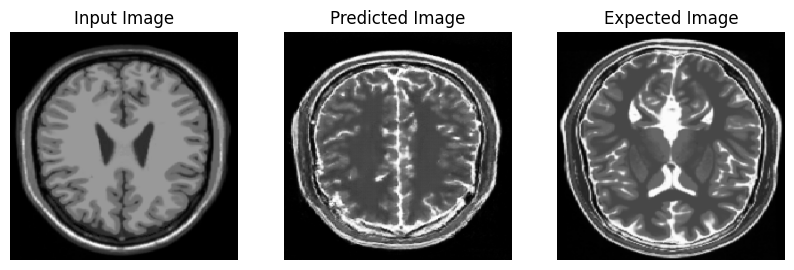

Saving checkpoint for epoch 11 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-262


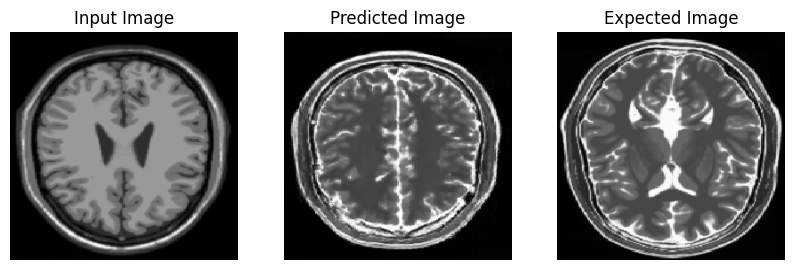

Saving checkpoint for epoch 12 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-263


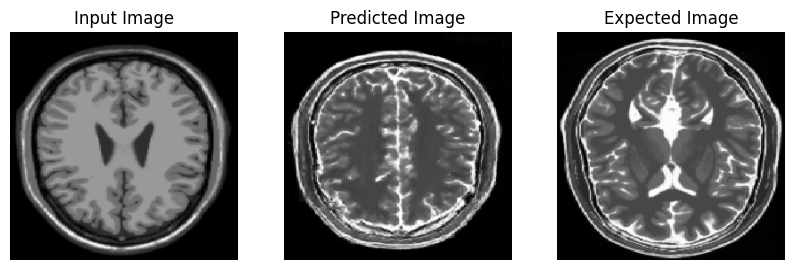

Saving checkpoint for epoch 13 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-264


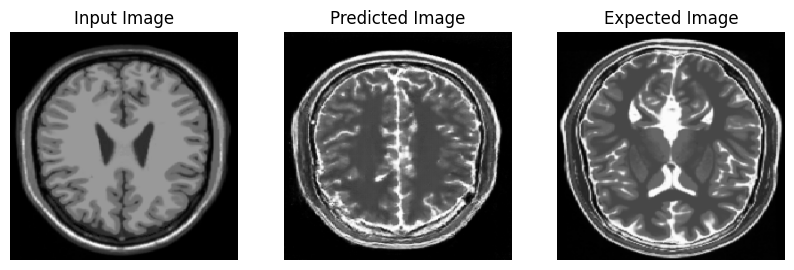

Saving checkpoint for epoch 14 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-265


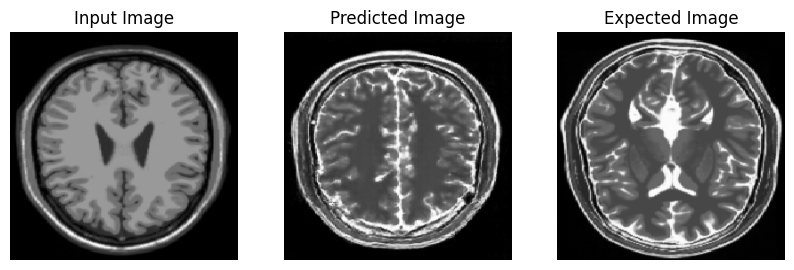

Saving checkpoint for epoch 15 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-266


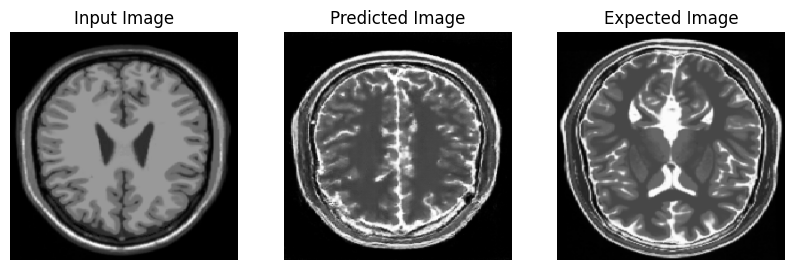

Saving checkpoint for epoch 16 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-267


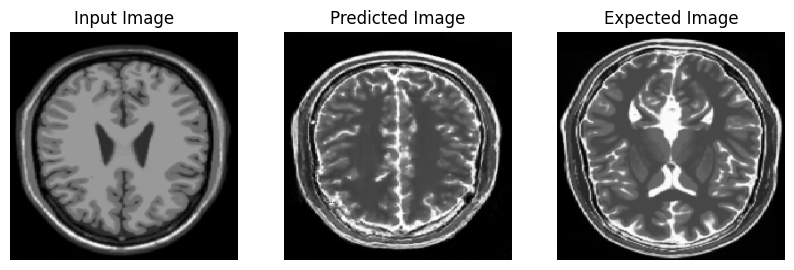

Saving checkpoint for epoch 17 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-268


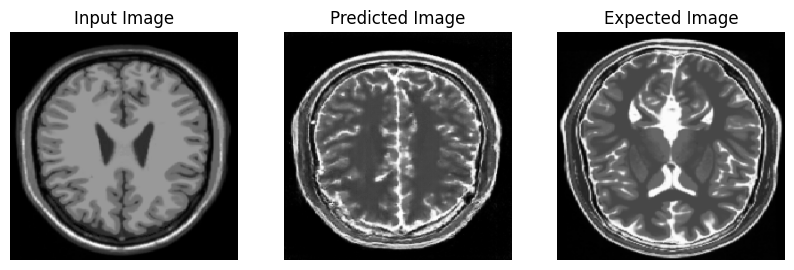

Saving checkpoint for epoch 18 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-269


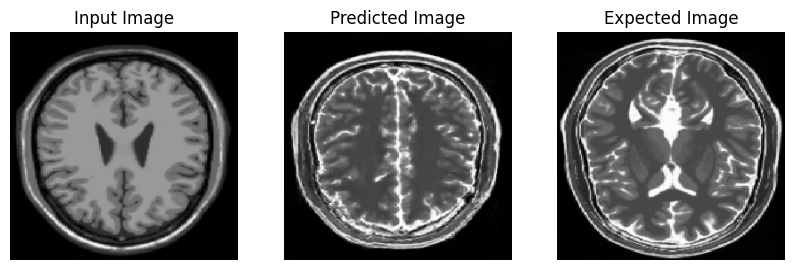

Saving checkpoint for epoch 19 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-270


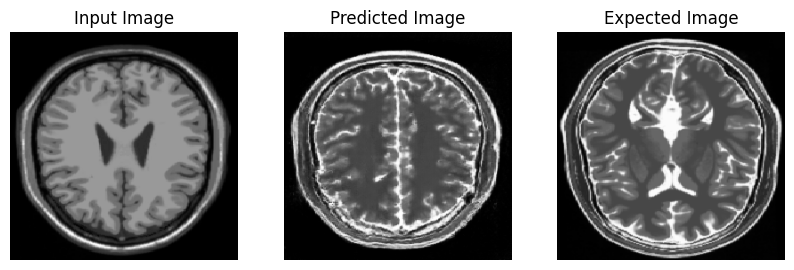

Saving checkpoint for epoch 20 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-271


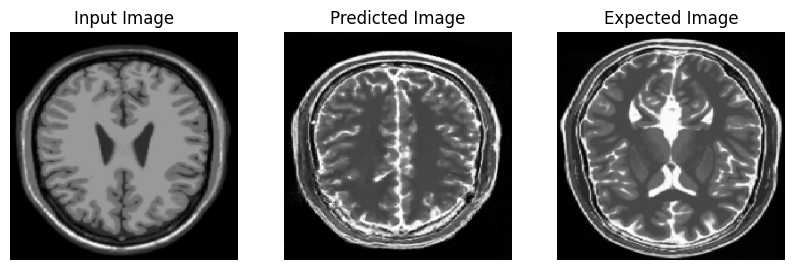

Saving checkpoint for epoch 21 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-272


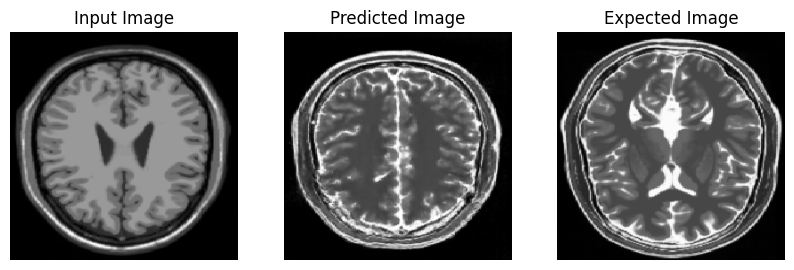

Saving checkpoint for epoch 22 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-273


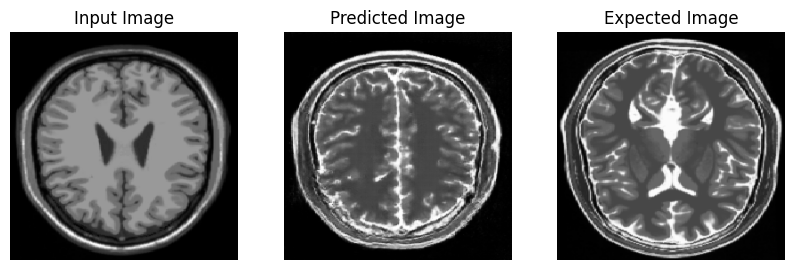

Saving checkpoint for epoch 23 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-274


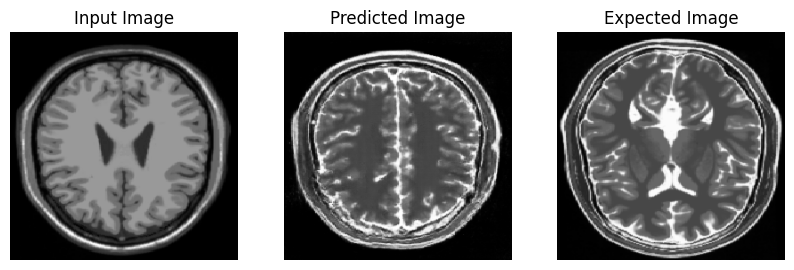

Saving checkpoint for epoch 24 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-275


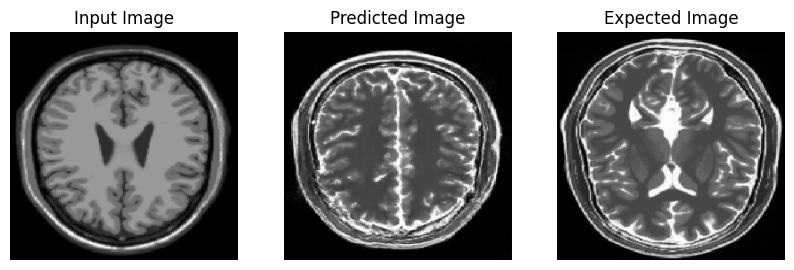

Saving checkpoint for epoch 25 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-276


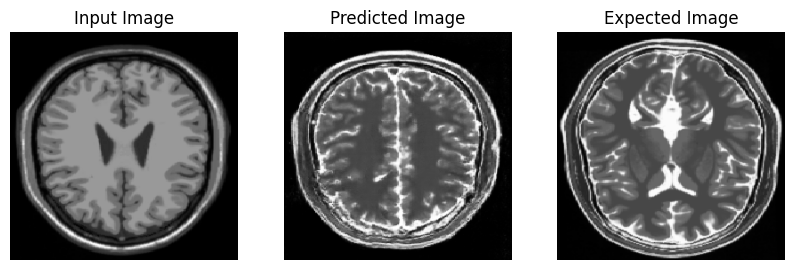

Saving checkpoint for epoch 26 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-277


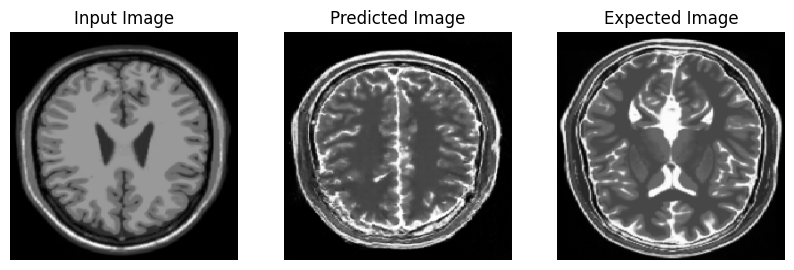

Saving checkpoint for epoch 27 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-278


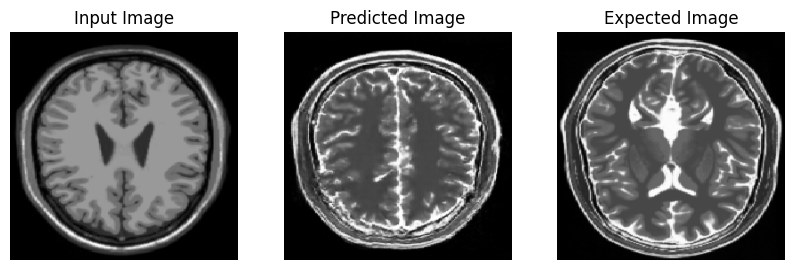

Saving checkpoint for epoch 28 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-279


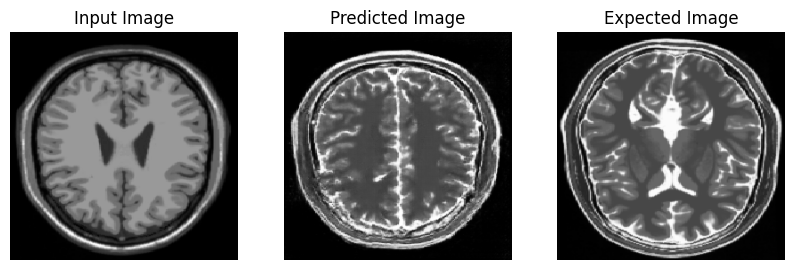

Saving checkpoint for epoch 29 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-280


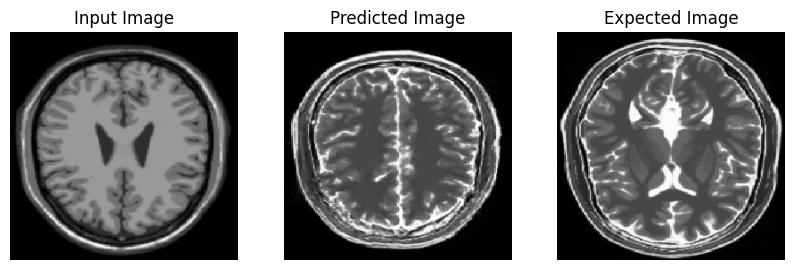

Saving checkpoint for epoch 30 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-281


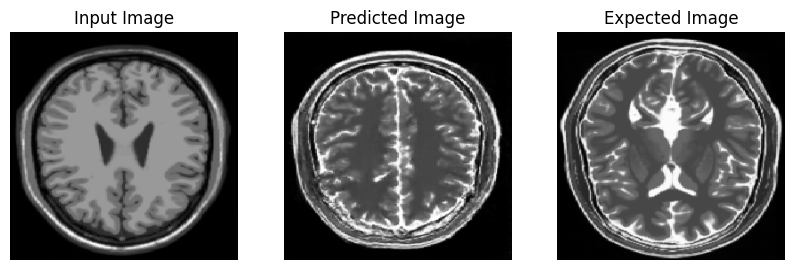

Saving checkpoint for epoch 31 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-282


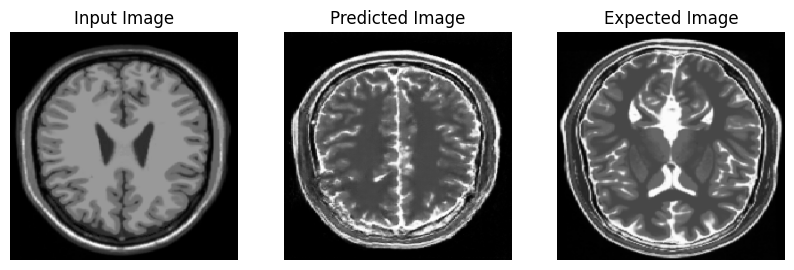

Saving checkpoint for epoch 32 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-283


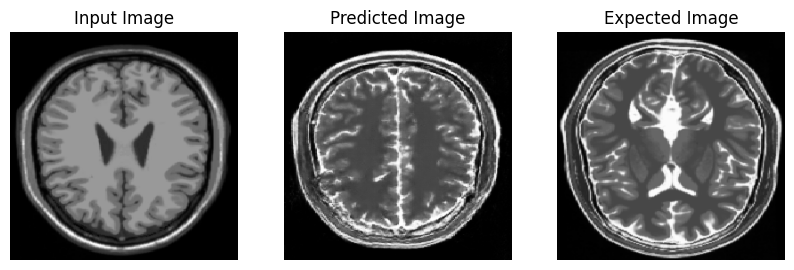

Saving checkpoint for epoch 33 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-284


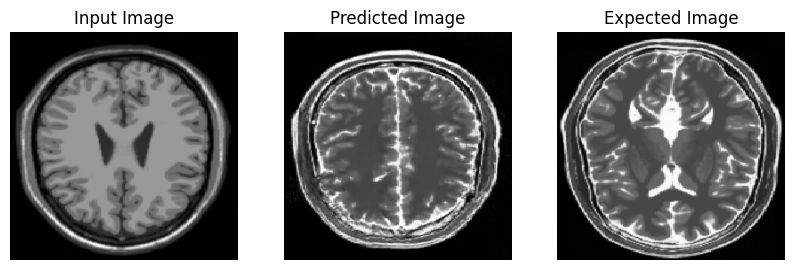

Saving checkpoint for epoch 34 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-285


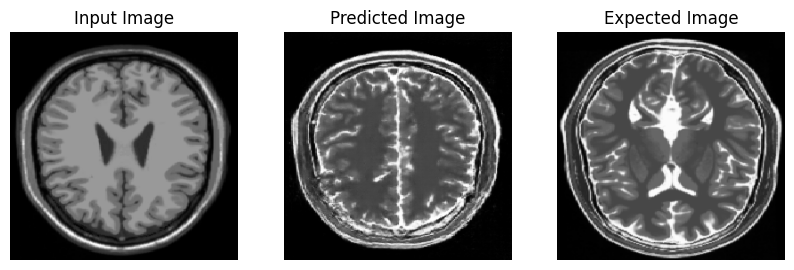

Saving checkpoint for epoch 35 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-286


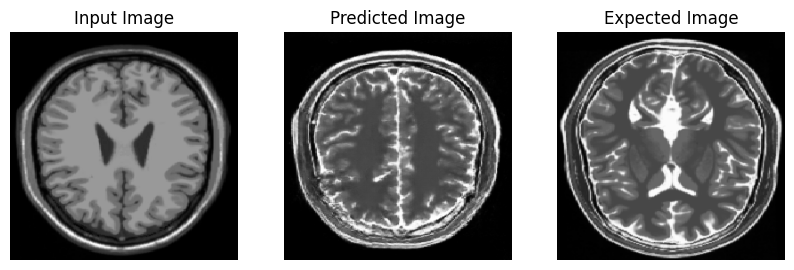

Saving checkpoint for epoch 36 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-287


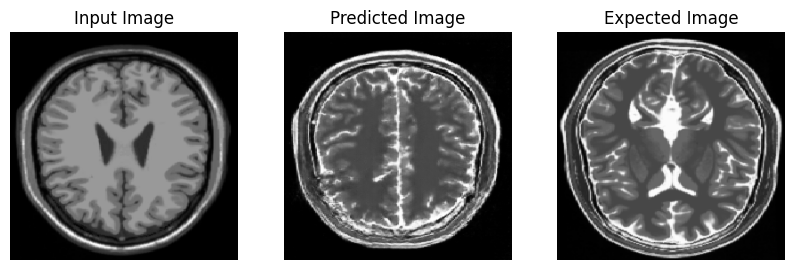

Saving checkpoint for epoch 37 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-288


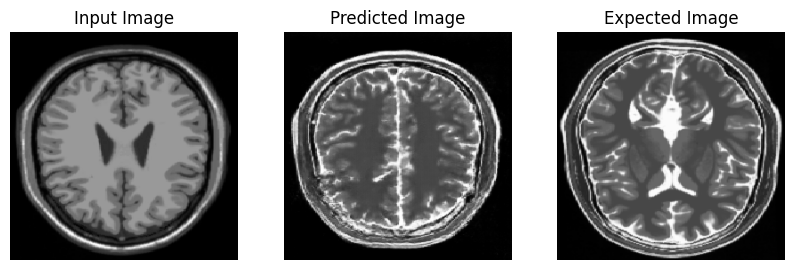

Saving checkpoint for epoch 38 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-289


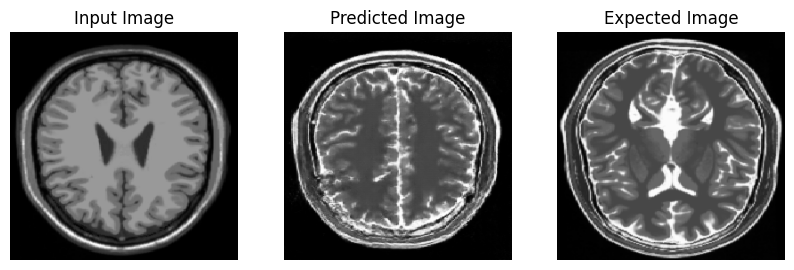

Saving checkpoint for epoch 39 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-290


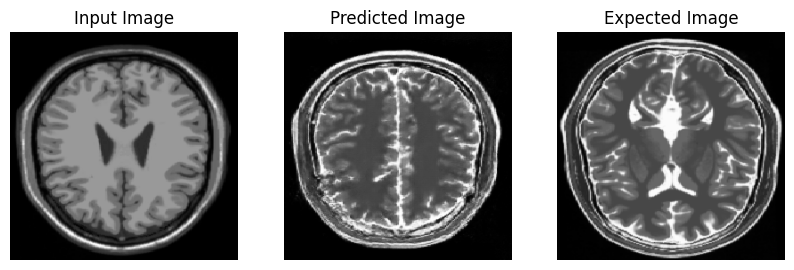

Saving checkpoint for epoch 40 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-291


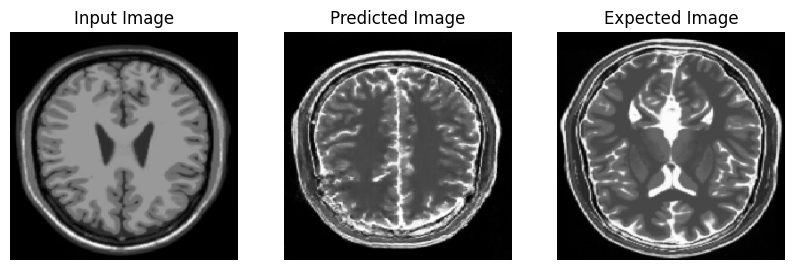

Saving checkpoint for epoch 41 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-292


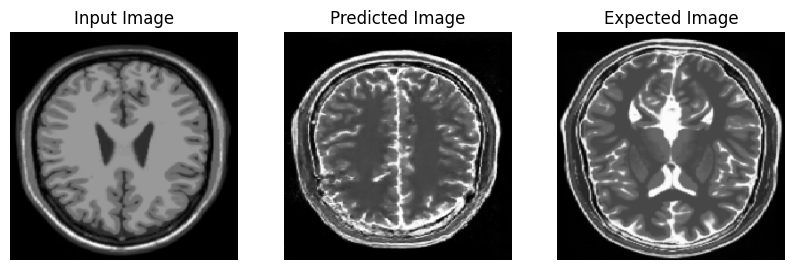

Saving checkpoint for epoch 42 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-293


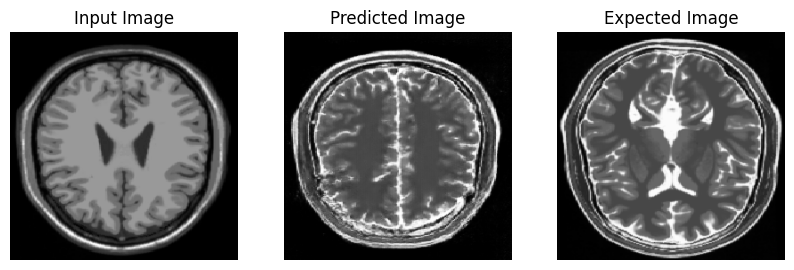

Saving checkpoint for epoch 43 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-294


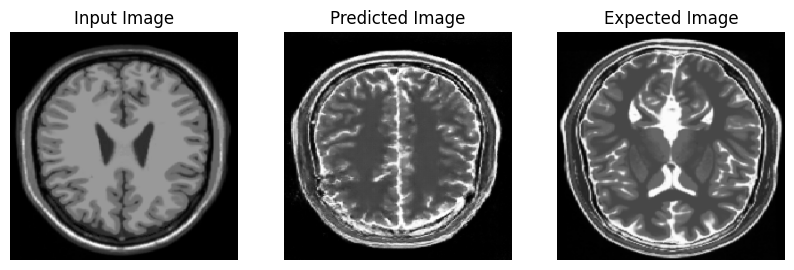

Saving checkpoint for epoch 44 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-295


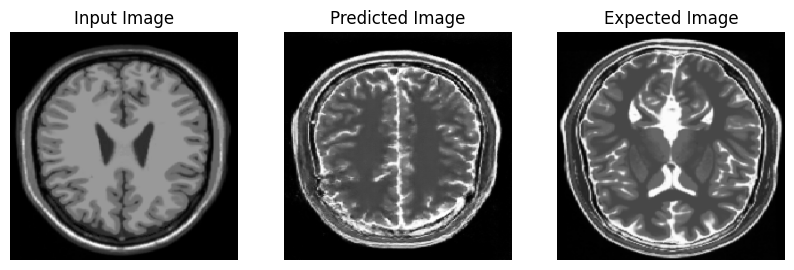

Saving checkpoint for epoch 45 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-296


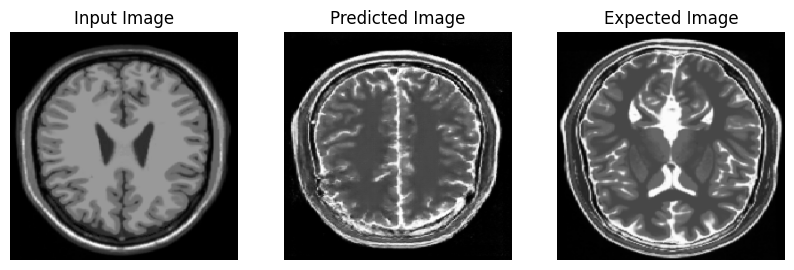

Saving checkpoint for epoch 46 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-297


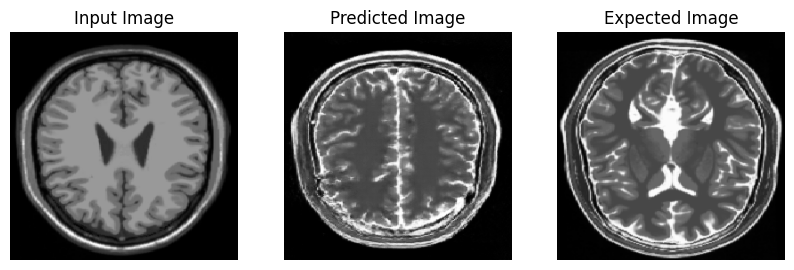

Saving checkpoint for epoch 47 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-298


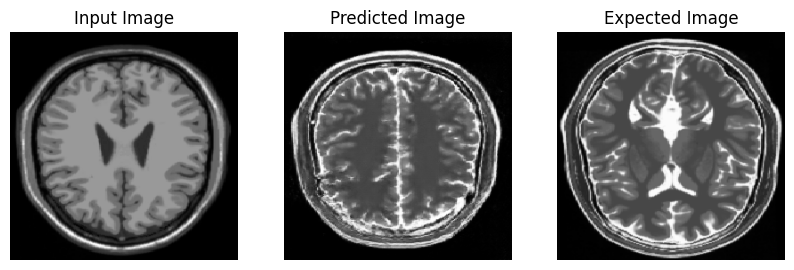

Saving checkpoint for epoch 48 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-299


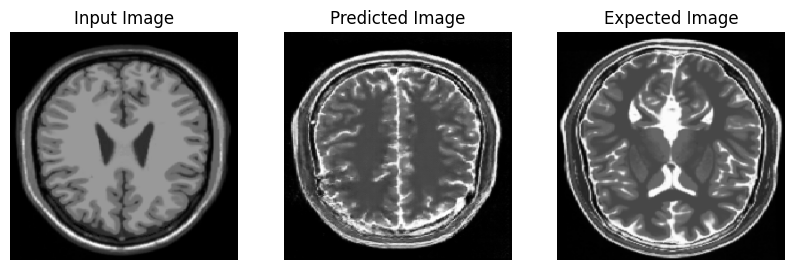

Saving checkpoint for epoch 49 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-300


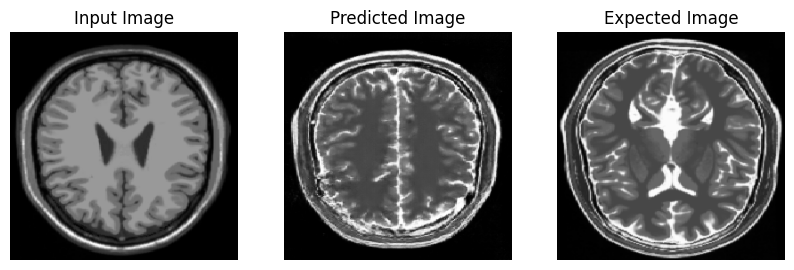

Saving checkpoint for epoch 50 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-301


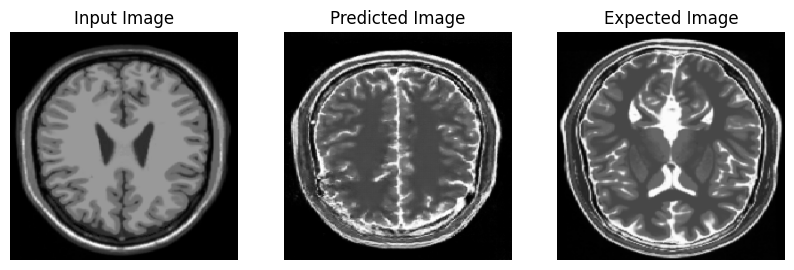

Saving checkpoint for epoch 51 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-302


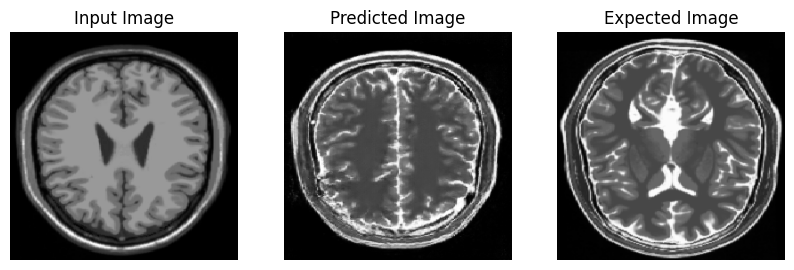

Saving checkpoint for epoch 52 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-303


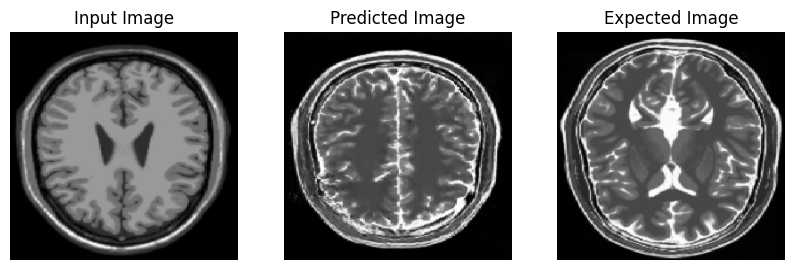

Saving checkpoint for epoch 53 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-304


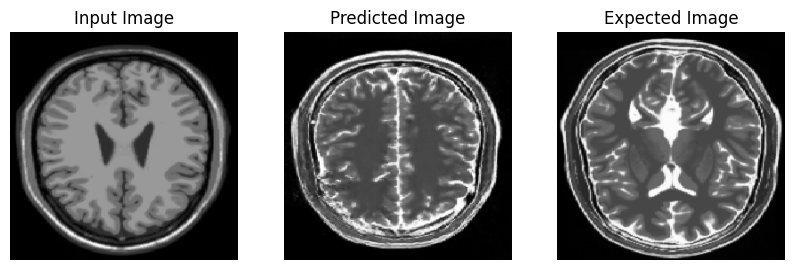

Saving checkpoint for epoch 54 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-305


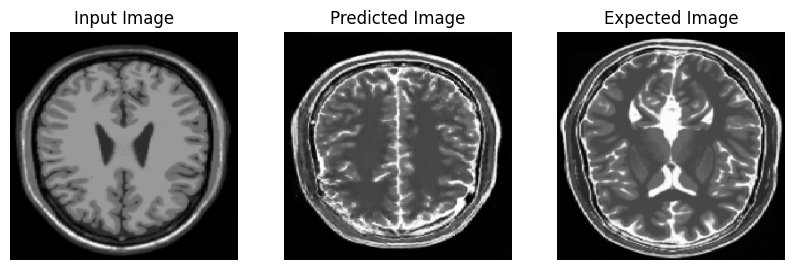

Saving checkpoint for epoch 55 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-306


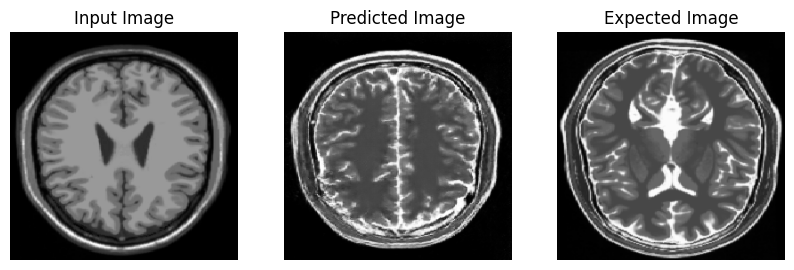

Saving checkpoint for epoch 56 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-307


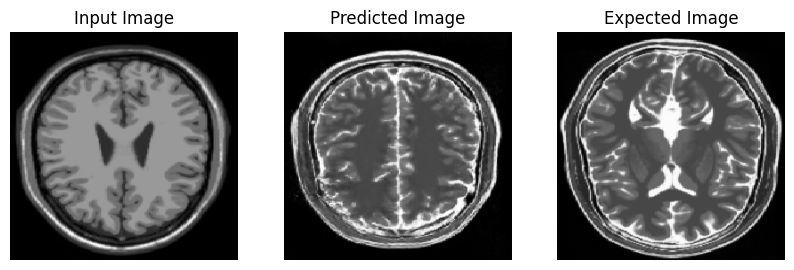

Saving checkpoint for epoch 57 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-308


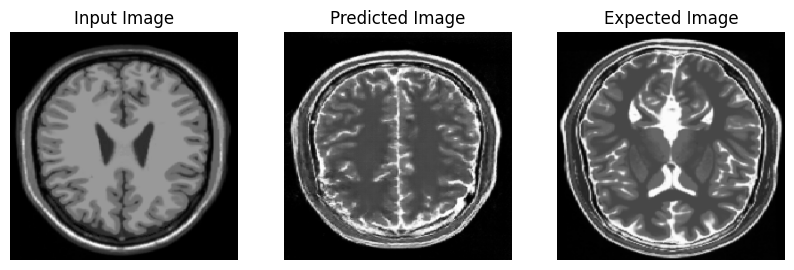

Saving checkpoint for epoch 58 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-309


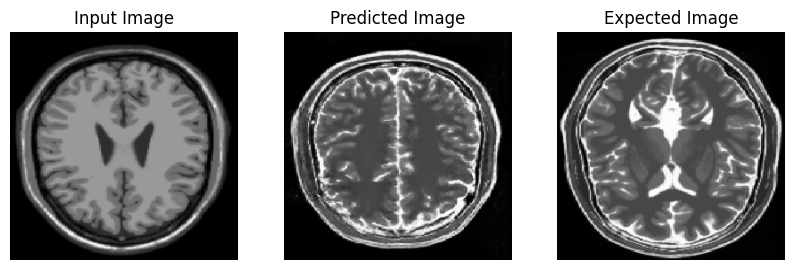

Saving checkpoint for epoch 59 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-310


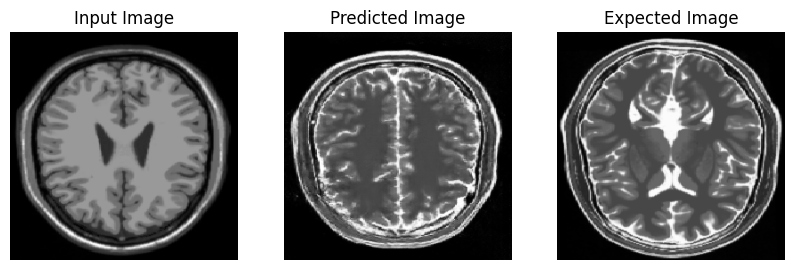

Saving checkpoint for epoch 60 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-311


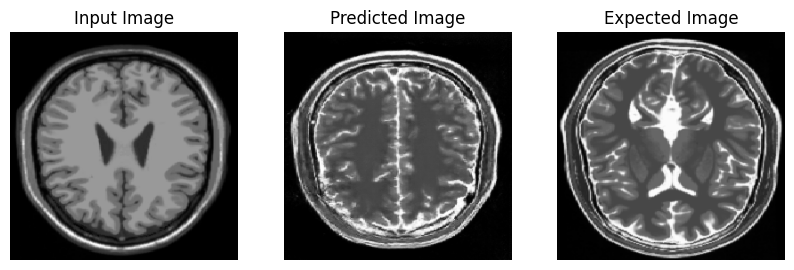

Saving checkpoint for epoch 61 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-312


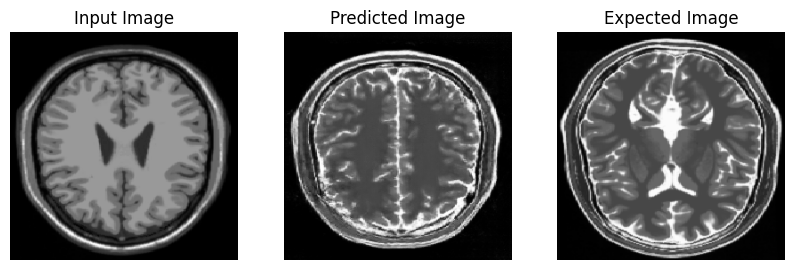

Saving checkpoint for epoch 62 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-313


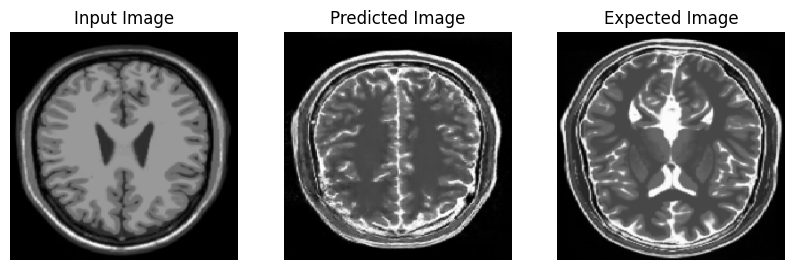

Saving checkpoint for epoch 63 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-314


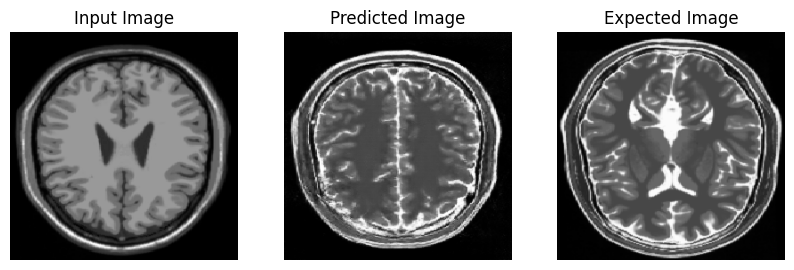

Saving checkpoint for epoch 64 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-315


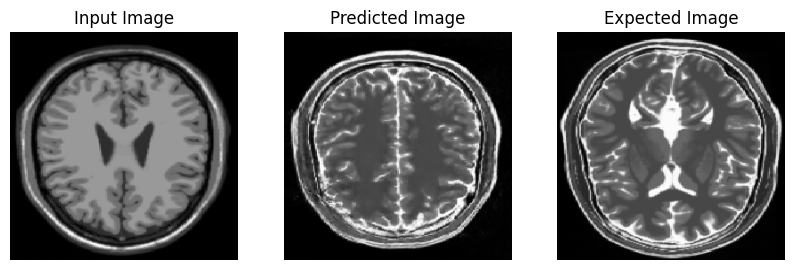

Saving checkpoint for epoch 65 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-316


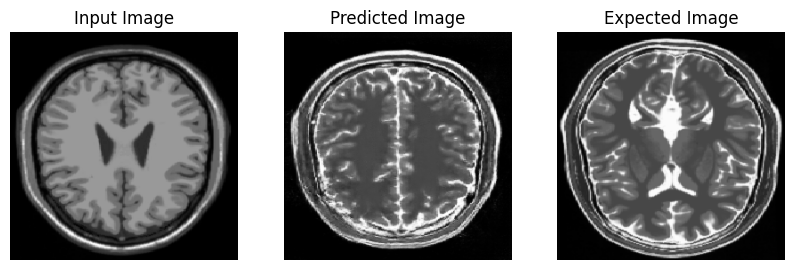

Saving checkpoint for epoch 66 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-317


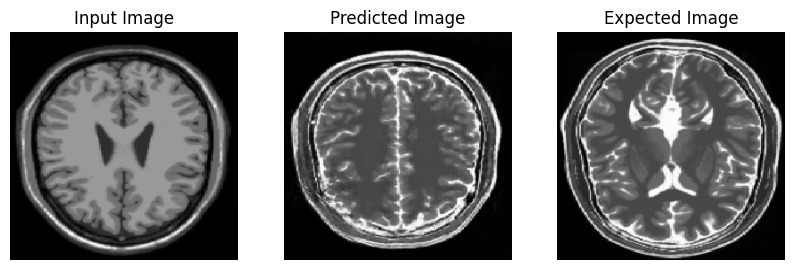

Saving checkpoint for epoch 67 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-318


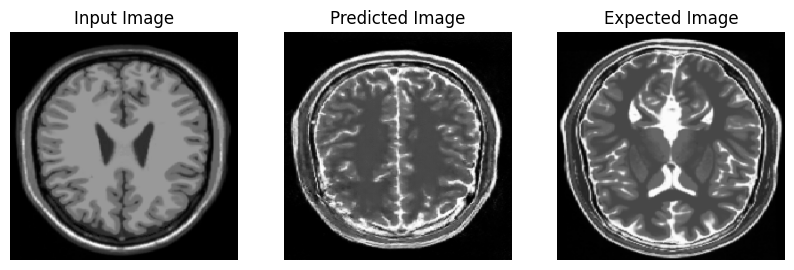

Saving checkpoint for epoch 68 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-319


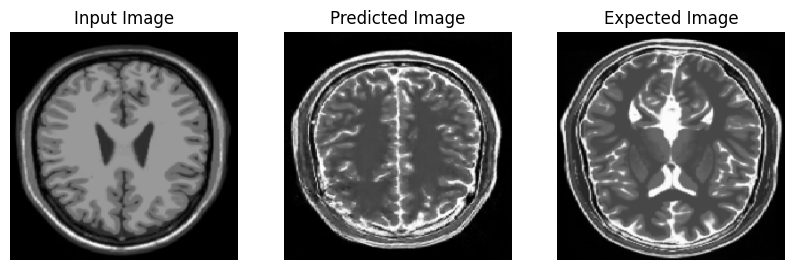

Saving checkpoint for epoch 69 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-320


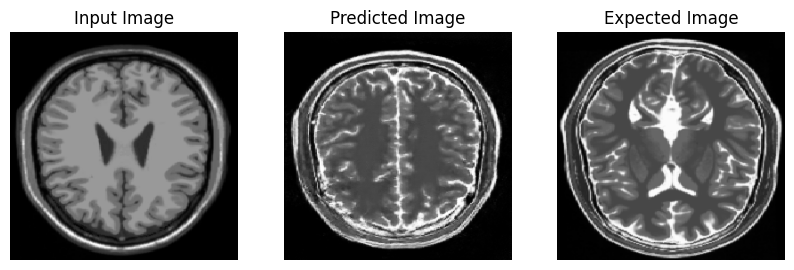

Saving checkpoint for epoch 70 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-321


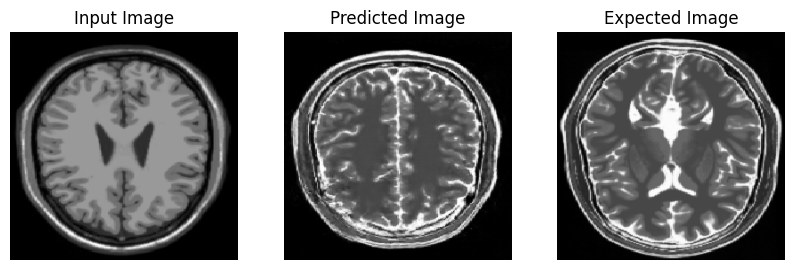

Saving checkpoint for epoch 71 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-322


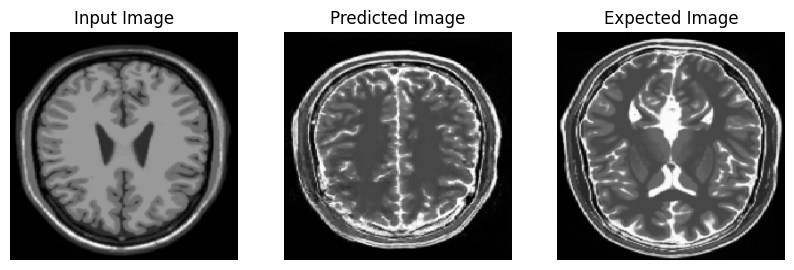

Saving checkpoint for epoch 72 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-323


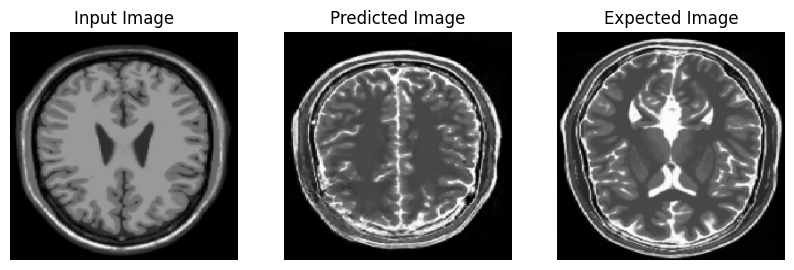

Saving checkpoint for epoch 73 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-324


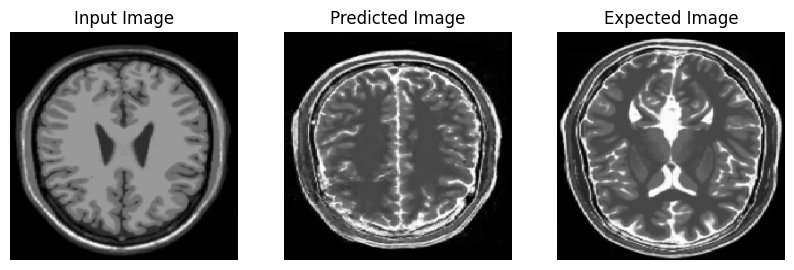

Saving checkpoint for epoch 74 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-325


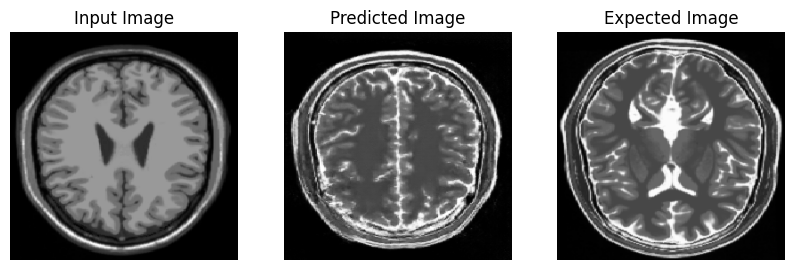

Saving checkpoint for epoch 75 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-326


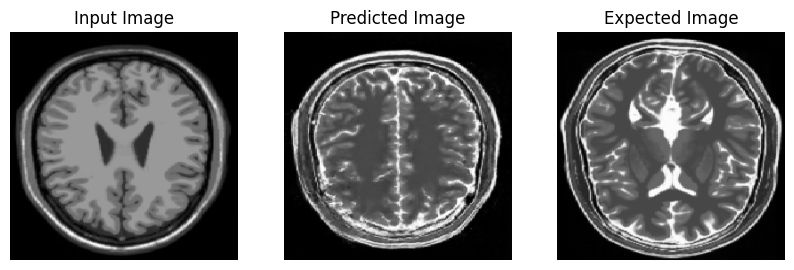

Saving checkpoint for epoch 76 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-327


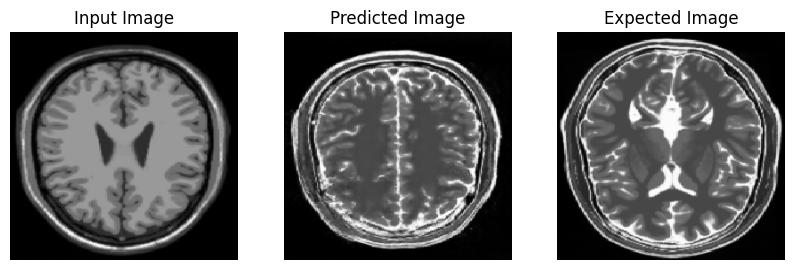

Saving checkpoint for epoch 77 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-328


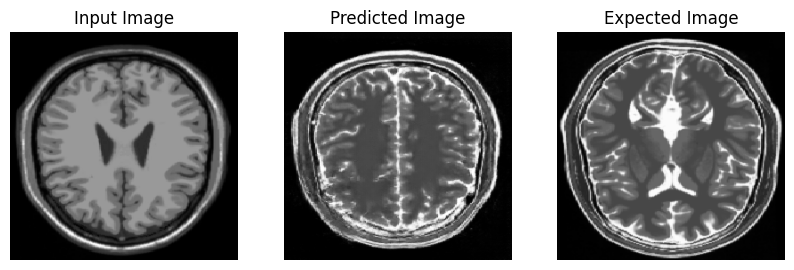

Saving checkpoint for epoch 78 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-329


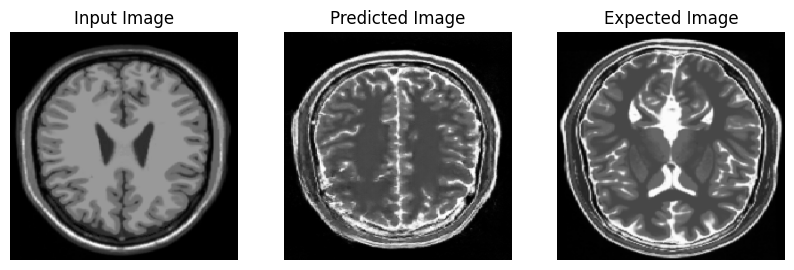

Saving checkpoint for epoch 79 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-330


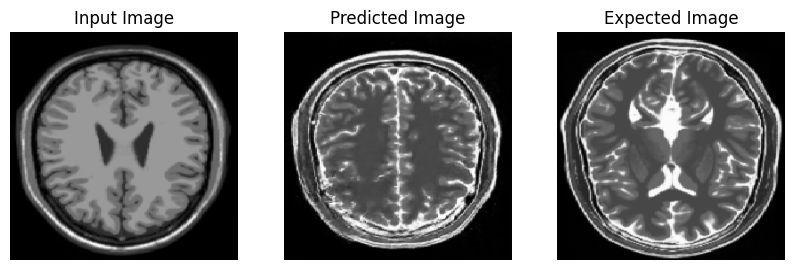

Saving checkpoint for epoch 80 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-331


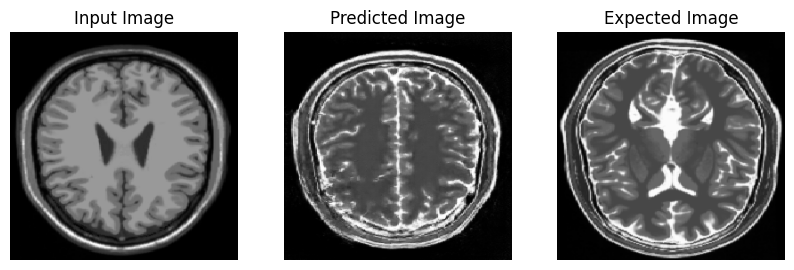

Saving checkpoint for epoch 81 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-332


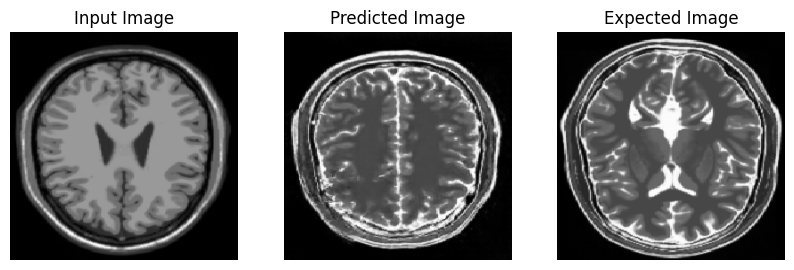

Saving checkpoint for epoch 82 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-333


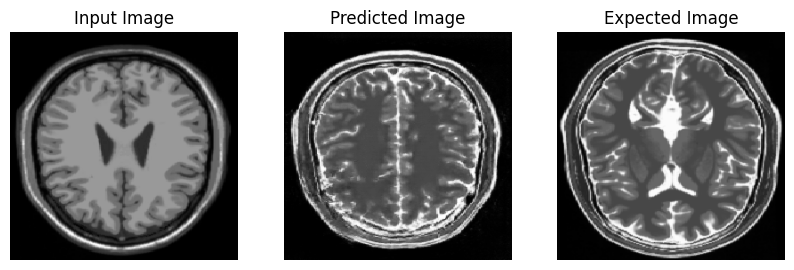

Saving checkpoint for epoch 83 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-334


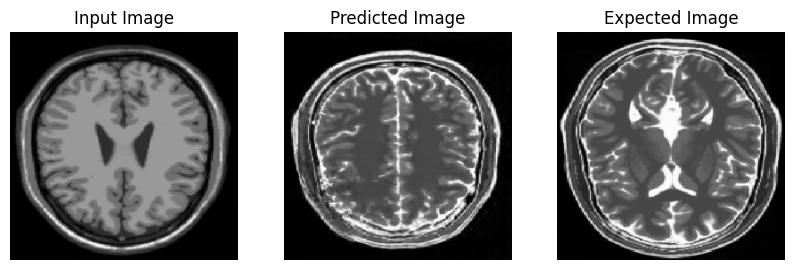

Saving checkpoint for epoch 84 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-335


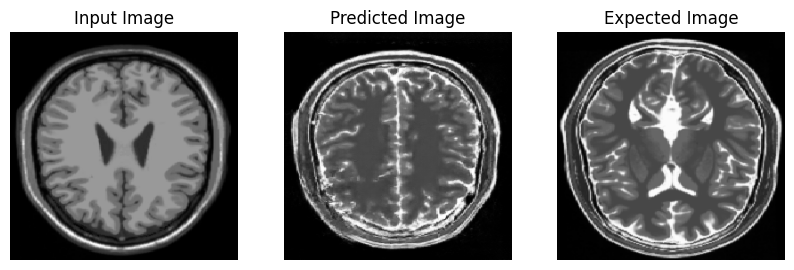

Saving checkpoint for epoch 85 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-336


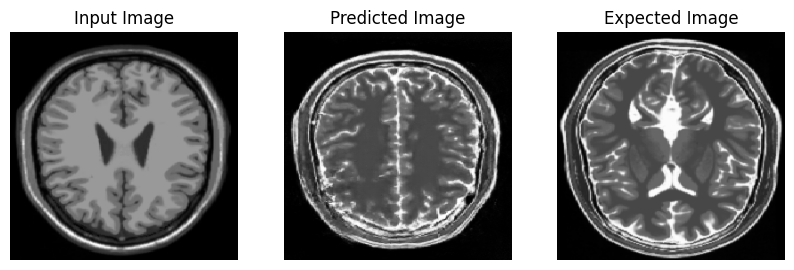

Saving checkpoint for epoch 86 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-337


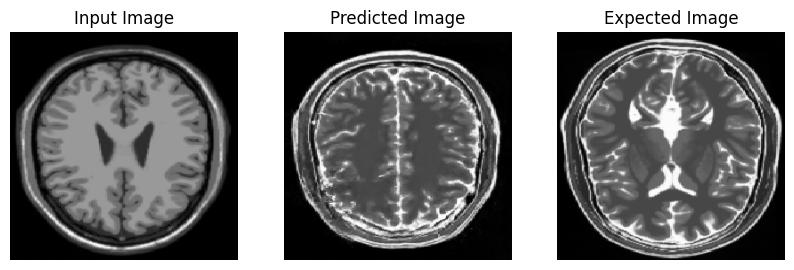

Saving checkpoint for epoch 87 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-338


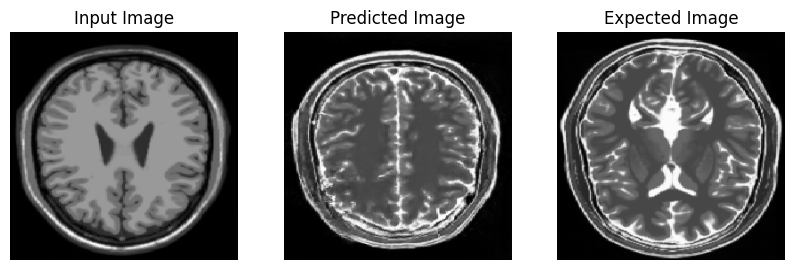

Saving checkpoint for epoch 88 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-339


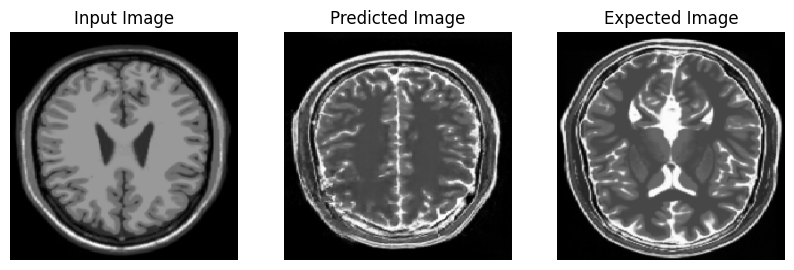

Saving checkpoint for epoch 89 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-340


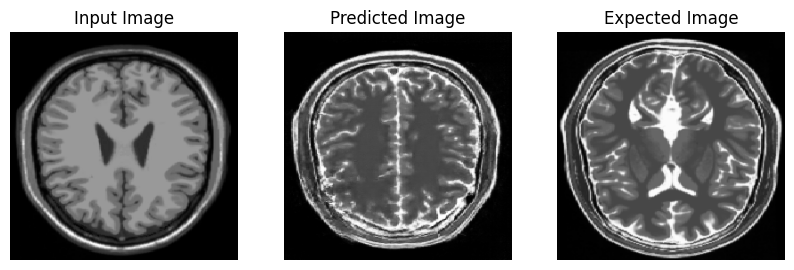

Saving checkpoint for epoch 90 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-341


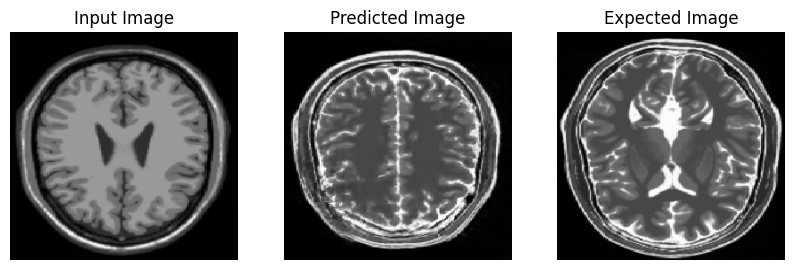

Saving checkpoint for epoch 91 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-342


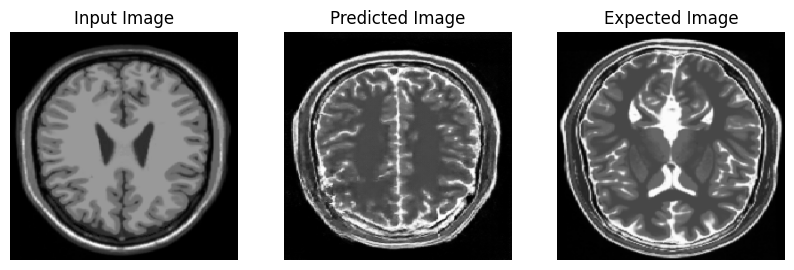

Saving checkpoint for epoch 92 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-343


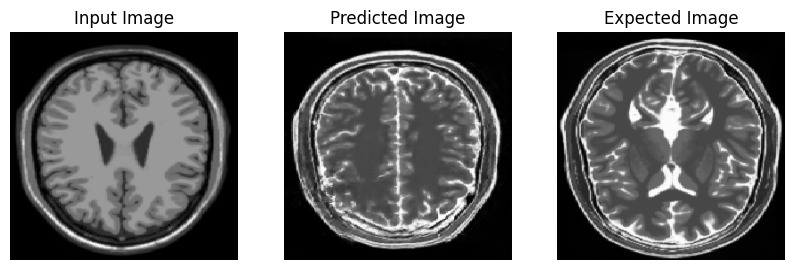

Saving checkpoint for epoch 93 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-344


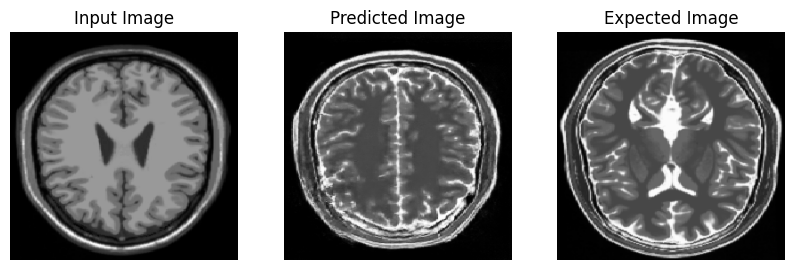

Saving checkpoint for epoch 94 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-345


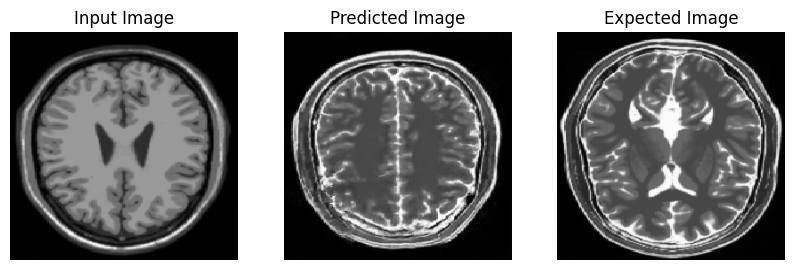

Saving checkpoint for epoch 95 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-346


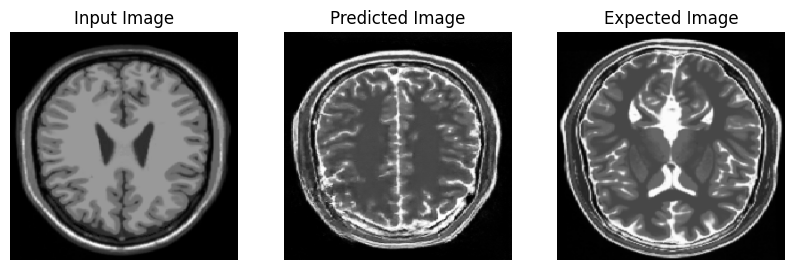

Saving checkpoint for epoch 96 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-347


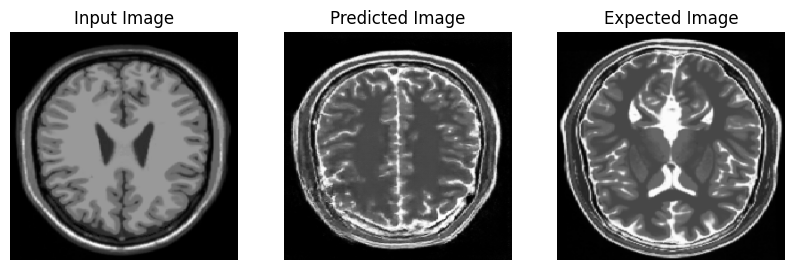

Saving checkpoint for epoch 97 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-348


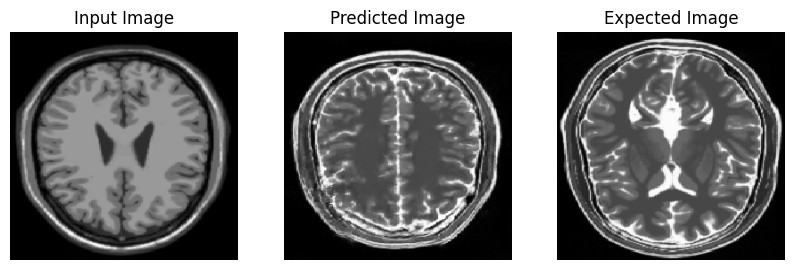

Saving checkpoint for epoch 98 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-349


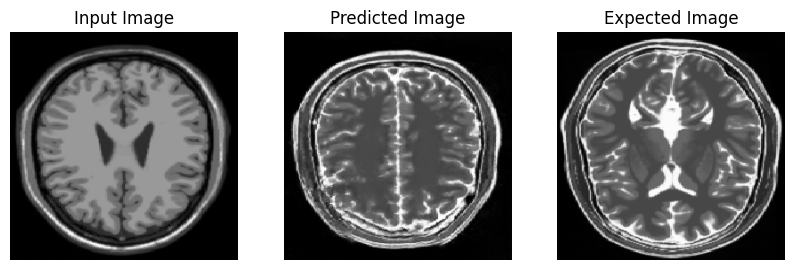

Saving checkpoint for epoch 99 at E:\some\ML -assignments\capstone\MRI_Models\ckpt-350


In [64]:
for epoch in range(EPOCHS):
    for image_x, image_y in tf.data.Dataset.zip((tr1, tr2)):
        train_step(image_x, image_y)
    generate_images(generator_g, sample_tr1, sample_tr2)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

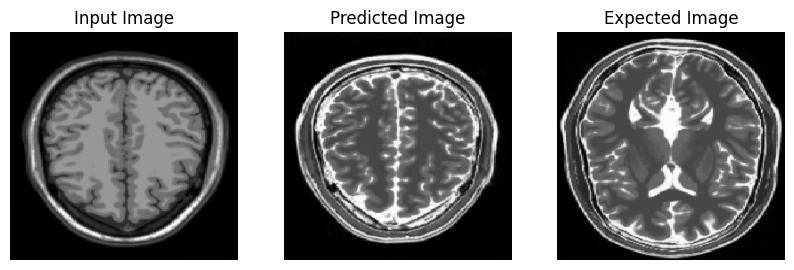

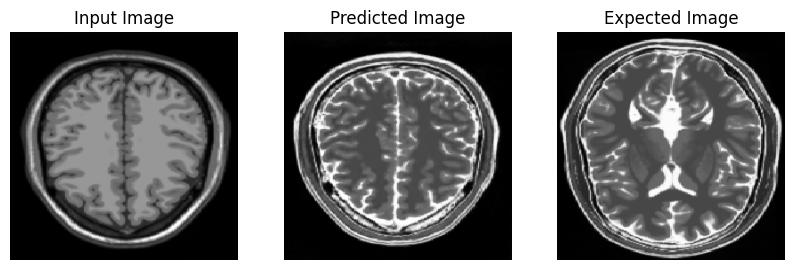

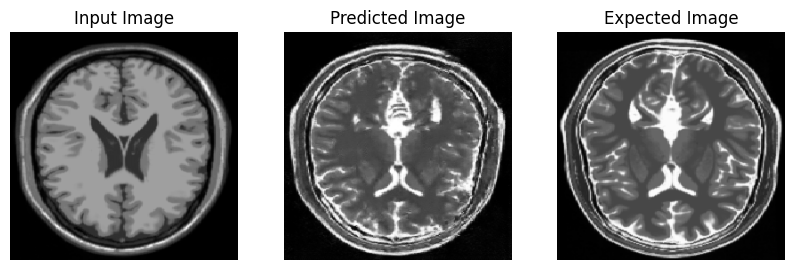

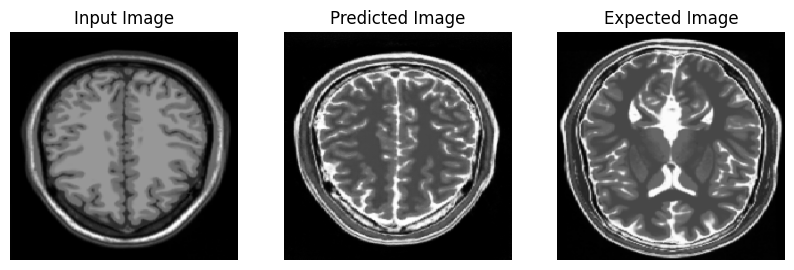

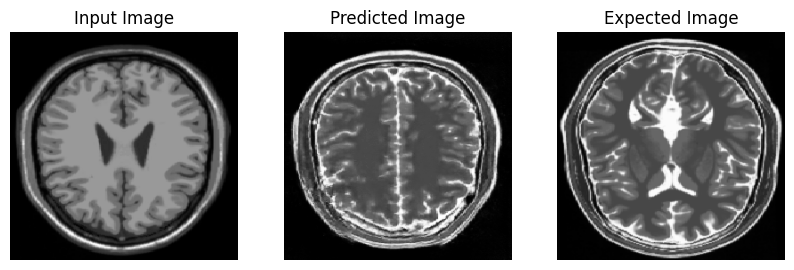

In [66]:
# Run the trained model on the test dataset
for inp in tr1.take(5):
    generate_images(generator_g, inp, sample_tr2)